In [73]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import norm
from scipy.stats import skew
from sklearn.model_selection import train_test_split
from sklearn import metrics
from sklearn.model_selection import cross_val_score, GridSearchCV, cross_validate
from sklearn.preprocessing import StandardScaler, PolynomialFeatures
from sklearn.linear_model import LinearRegression, Ridge, RidgeCV, Lasso, LassoCV, ElasticNet, ElasticNetCV
from yellowbrick.regressor import AlphaSelection, PredictionError, ResidualsPlot
from yellowbrick.model_selection import FeatureImportances

In [74]:
pd.options.display.float_format = '{:.10f}'.format
np.set_printoptions(precision=None, suppress=True)

In [75]:
pd.options.display.max_columns = 100
sns.set_style("whitegrid")

In [2]:
df = pd.read_csv("USA_Housing.csv")

In [4]:
df.head()

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price,Address
0,79545.458574,5.682861,7.009188,4.09,23086.800503,1.059034e+06,"208 Michael Ferry Apt. 674\nLaurabury, NE 3701..."
1,79248.642455,6.002900,6.730821,3.09,40173.072174,1.505891e+06,"188 Johnson Views Suite 079\nLake Kathleen, CA..."
2,61287.067179,5.865890,8.512727,5.13,36882.159400,1.058988e+06,"9127 Elizabeth Stravenue\nDanieltown, WI 06482..."
3,63345.240046,7.188236,5.586729,3.26,34310.242831,1.260617e+06,USS Barnett\nFPO AP 44820
4,59982.197226,5.040555,7.839388,4.23,26354.109472,6.309435e+05,USNS Raymond\nFPO AE 09386


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5000 entries, 0 to 4999
Data columns (total 7 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Avg. Area Income              5000 non-null   float64
 1   Avg. Area House Age           5000 non-null   float64
 2   Avg. Area Number of Rooms     5000 non-null   float64
 3   Avg. Area Number of Bedrooms  5000 non-null   float64
 4   Area Population               5000 non-null   float64
 5   Price                         5000 non-null   float64
 6   Address                       5000 non-null   object 
dtypes: float64(6), object(1)
memory usage: 273.6+ KB


In [6]:
df.describe()

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price
count,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5.000000e+03
mean,68583.108984,5.977222,6.987792,3.981330,36163.516039,1.232073e+06
std,10657.991214,0.991456,1.005833,1.234137,9925.650114,3.531176e+05
min,17796.631190,2.644304,3.236194,2.000000,172.610686,1.593866e+04
25%,61480.562388,5.322283,6.299250,3.140000,29403.928702,9.975771e+05
50%,68804.286404,5.970429,7.002902,4.050000,36199.406689,1.232669e+06
75%,75783.338666,6.650808,7.665871,4.490000,42861.290769,1.471210e+06
max,107701.748378,9.519088,10.759588,6.500000,69621.713378,2.469066e+06


In [7]:
df.columns

Index(['Avg. Area Income', 'Avg. Area House Age', 'Avg. Area Number of Rooms',
       'Avg. Area Number of Bedrooms', 'Area Population', 'Price', 'Address'],
      dtype='object')

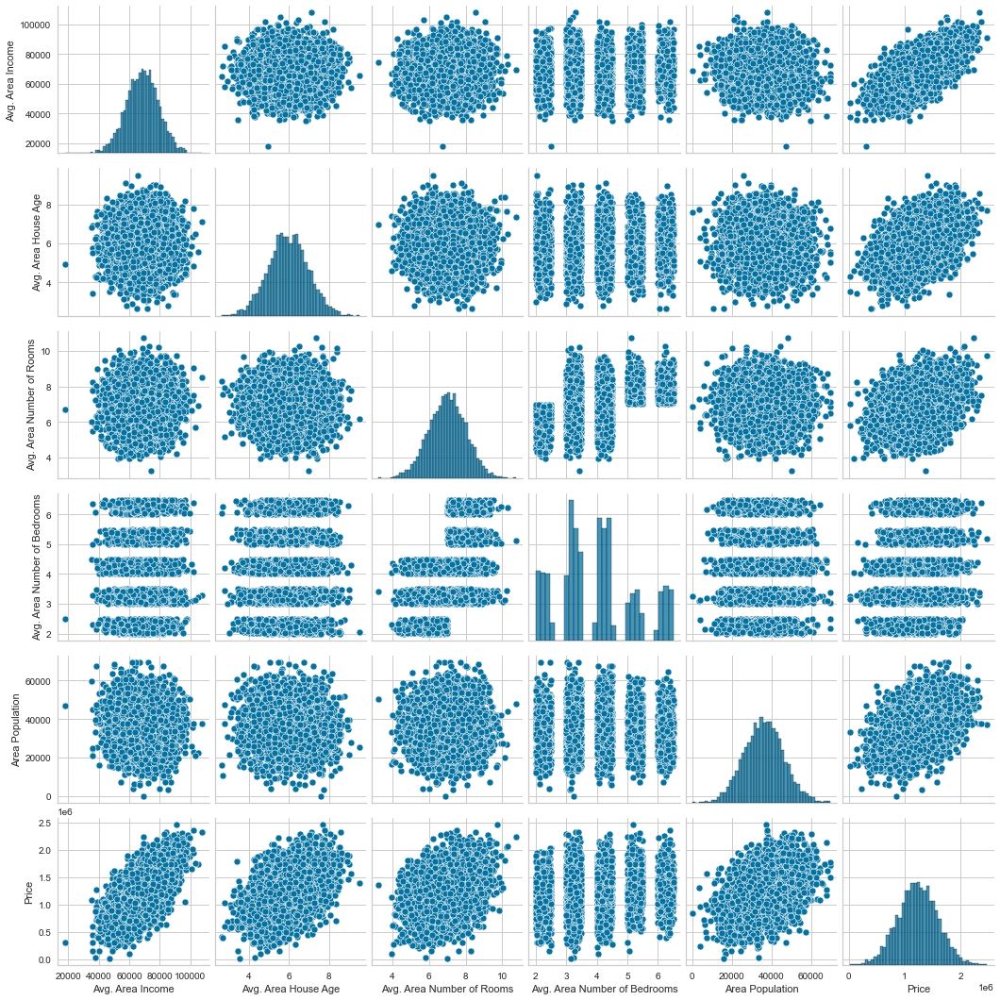

In [8]:
sns.pairplot(df)

<AxesSubplot:>

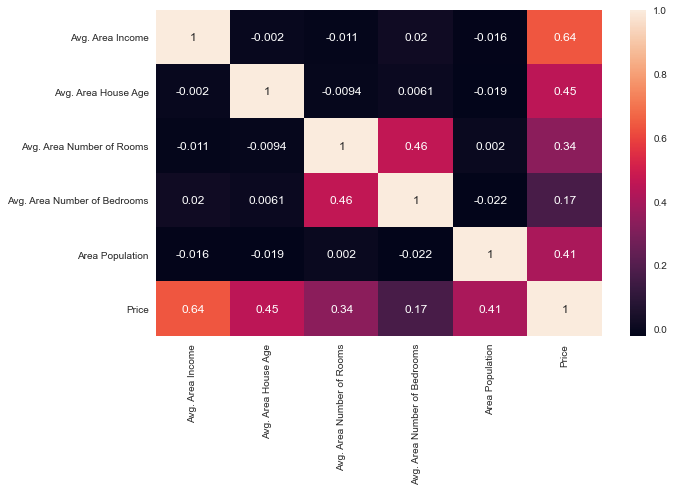

In [9]:
plt.figure(figsize=(10,6))
sns.heatmap(df.corr(), annot=True)

C:\Users\Ertuğrul\AppData\Local\Programs\Python\Python39\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


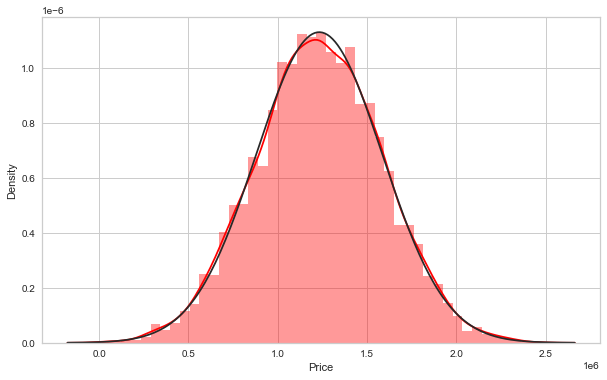

In [14]:
plt.figure(figsize=(10,6))
sns.distplot(df.Price, fit=norm, color='red');

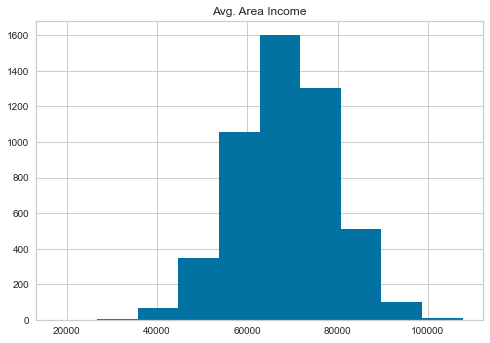

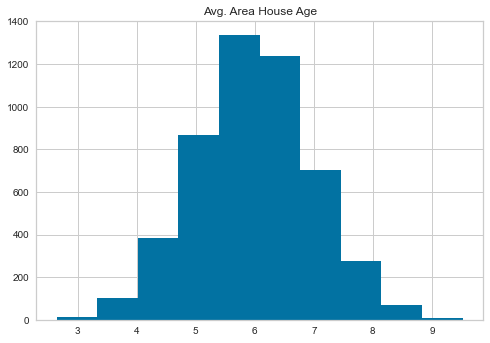

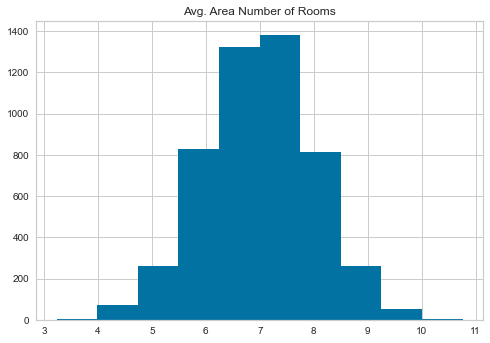

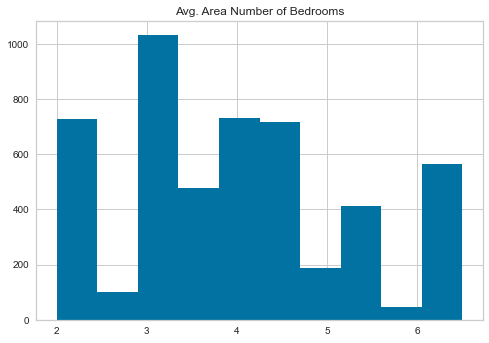

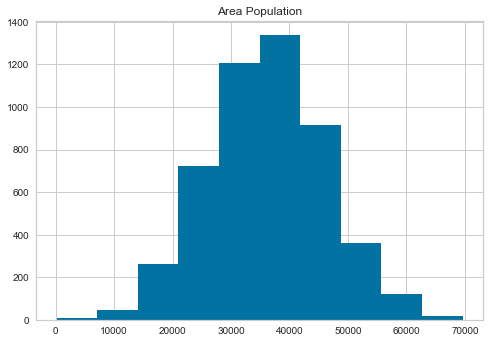

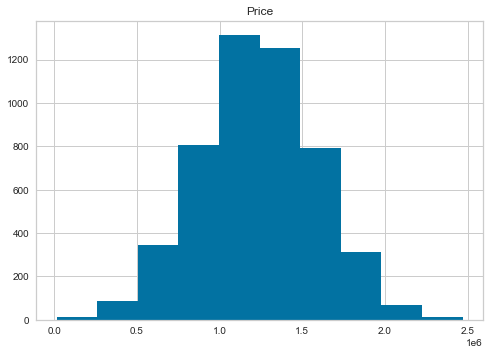

In [15]:
for column in df.select_dtypes(np.number).columns:
    plt.hist(df[column])
    plt.title(column)
    plt.show()

In [16]:
skew(df.select_dtypes(np.number))

array([-0.03370986, -0.00721171, -0.04098361,  0.37612752,  0.05063449,
       -0.00271725])

In [17]:
pd.DataFrame(data={'Column name':df.select_dtypes(np.number).columns, 'Skewness':skew(df.select_dtypes(np.number))})

,Column name,Skewness
0,Avg. Area Income,-0.033710
1,Avg. Area House Age,-0.007212
2,Avg. Area Number of Rooms,-0.040984
3,Avg. Area Number of Bedrooms,0.376128
4,Area Population,0.050634
5,Price,-0.002717


In [18]:
X = df.drop(columns=['Price', 'Address'])

In [19]:
y = df.Price

### Linear Regression

In [20]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [21]:
scores = cross_val_score(LinearRegression(), X, y, cv=10, n_jobs=-1, verbose=2) # n_jobs core number -1 max core number

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of  10 | elapsed:    1.1s remaining:    2.8s
[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:    1.2s finished


In [22]:
scores

array([0.91336093, 0.92112399, 0.91727189, 0.92360986, 0.91247623,
       0.91771186, 0.91672276, 0.92487908, 0.9212436 , 0.90539243])

In [23]:
scores.mean()

0.9173792621537329

In [24]:
scaler = StandardScaler()

In [25]:
X_train = scaler.fit_transform(X_train)

In [26]:
X_test = scaler.transform(X_test)

In [27]:
X_train.shape

(4000, 5)

In [28]:
X_test.shape

(1000, 5)

In [29]:
lm_cross_val = pd.DataFrame(cross_validate(LinearRegression(), X_train, y_train, cv=10, n_jobs=-1, verbose=2))

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done   3 out of  10 | elapsed:    0.0s remaining:    0.1s
[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:    0.0s finished


In [30]:
lm_cross_val

,fit_time,score_time,test_score
0,0.001002,0.000000,0.909172
1,0.002003,0.001001,0.917270
2,0.002002,0.000000,0.912819
3,0.001002,0.000000,0.906979
4,0.001001,0.001002,0.917508
5,0.002002,0.000000,0.921502
6,0.001001,0.000000,0.920300
7,0.002002,0.000000,0.920258
8,0.001000,0.001001,0.919421
9,0.002002,0.000000,0.927613


In [31]:
lm_cross_val.test_score.mean()

0.9172842372889519

In [32]:
lm = LinearRegression()

In [33]:
lm.fit(X_train, y_train)

LinearRegression()

In [34]:
y_pred = lm.predict(X_test)

In [35]:
len(y_pred)

1000

In [36]:
lm.score(X_train, y_train)

0.9179787435623722

In [38]:
lm.score(X_test, y_test)

0.9179971706834331

In [39]:
coeff_df = pd.DataFrame(lm.coef_, X.columns, columns=['Coefficient'])

In [40]:
coeff_df

,Coefficient
Avg. Area Income,231741.876652
Avg. Area House Age,163580.776566
Avg. Area Number of Rooms,120724.771387
Avg. Area Number of Bedrooms,2992.449135
Area Population,152235.900097


In [41]:
lm.intercept_

1229576.9925600903

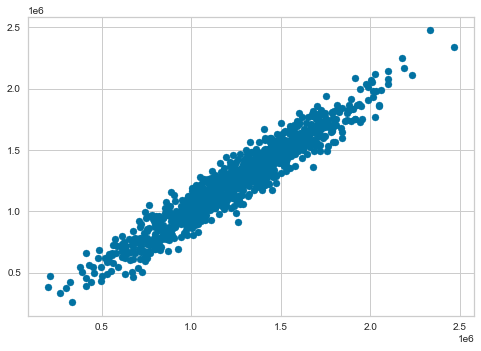

In [43]:
plt.scatter(y_test, y_pred)

C:\Users\Ertuğrul\AppData\Local\Programs\Python\Python39\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


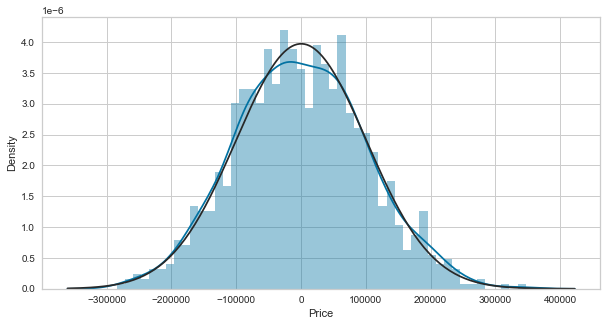

In [44]:
plt.figure(figsize=(10, 5))
sns.distplot((y_test - y_pred), bins=50, fit=norm);

In [45]:
def print_evaluate(true, predicted):
    mae = metrics.mean_absolute_error(true, predicted)
    mse = metrics.mean_squared_error(true, predicted)
    rmse = np.sqrt(metrics.mean_squared_error(true, predicted))
    r2_square = metrics.r2_score(true, predicted)
    print('MAE:', mae)
    print('MSE:', mse)
    print('RMSE:', rmse)
    print('R2 Square', r2_square)
    print('__________________________________')

In [46]:
print_evaluate(y_test, y_pred)

MAE: 80879.09723489445
MSE: 10089009300.89399
RMSE: 100444.06055558482
R2 Square 0.9179971706834331
__________________________________


In [47]:
final_scores = pd.DataFrame(index=['MAE', 'MSE', 'RMSE', 'R2_Score'], data=[80879.09723489442, 0089009300.893988, 100444.0605555848, 0.9179971706834331], columns=['LinearModel'])

In [48]:
final_scores

,LinearModel
MAE,8.087910e+04
MSE,8.900930e+07
RMSE,1.004441e+05
R2_Score,9.179972e-01


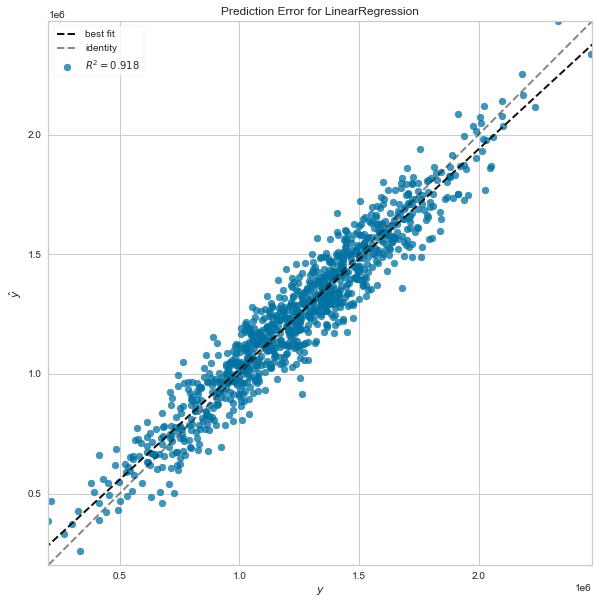

<AxesSubplot:title={'center':'Prediction Error for LinearRegression'}, xlabel='$y$', ylabel='$\\hat{y}$'>

In [49]:
plt.figure(figsize=(10, 10))
visualizer = PredictionError(LinearRegression())
visualizer.fit(X_train, y_train)
visualizer.score(X_test, y_test)
visualizer.show()

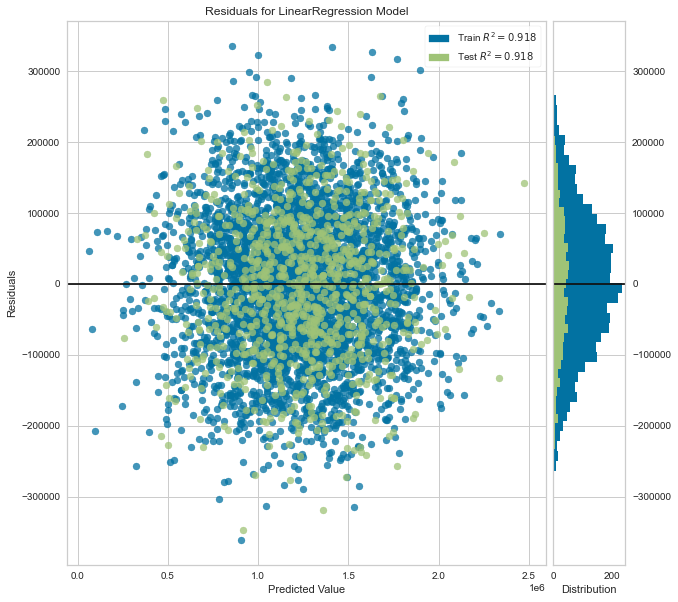

<AxesSubplot:title={'center':'Residuals for LinearRegression Model'}, xlabel='Predicted Value', ylabel='Residuals'>

In [50]:
plt.figure(figsize=(10, 10))
model = ResidualsPlot(LinearRegression())
model.fit(X_train, y_train)
model.score(X_test, y_test)
model.show()

### Ridge Regression

In [51]:
rm = Ridge(alpha=100, random_state=42)

In [53]:
rm.fit(X_train, y_train)

Ridge(alpha=100, random_state=42)

In [54]:
rm_pred = rm.predict(X_test)

In [55]:
rm.score(X_train, y_train)

0.9173801693353605

In [56]:
rm.score(X_test, y_test)

0.9174033945344908

In [66]:
alpha_space = np.linspace(0.01, 40, 300)

In [67]:
alpha_dict = {'alpha': alpha_space}

In [68]:
clf = GridSearchCV(Ridge(random_state=42), alpha_dict, n_jobs=-1, verbose=2)

In [69]:
clf.fit(X_train, y_train)

Fitting 5 folds for each of 300 candidates, totalling 1500 fits


GridSearchCV(estimator=Ridge(random_state=42), n_jobs=-1,
             param_grid={'alpha': array([1.00000000e-02, 1.43745819e-01, 2.77491639e-01, 4.11237458e-01,
       5.44983278e-01, 6.78729097e-01, 8.12474916e-01, 9.46220736e-01,
       1.07996656e+00, 1.21371237e+00, 1.34745819e+00, 1.48120401e+00,
       1.61494983e+00, 1.74869565e+00, 1.88244147e+00, 2.01618729e+00,
       2.14993311e+00, 2.28367893e+...
       3.69238462e+01, 3.70575920e+01, 3.71913378e+01, 3.73250836e+01,
       3.74588294e+01, 3.75925753e+01, 3.77263211e+01, 3.78600669e+01,
       3.79938127e+01, 3.81275585e+01, 3.82613043e+01, 3.83950502e+01,
       3.85287960e+01, 3.86625418e+01, 3.87962876e+01, 3.89300334e+01,
       3.90637793e+01, 3.91975251e+01, 3.93312709e+01, 3.94650167e+01,
       3.95987625e+01, 3.97325084e+01, 3.98662542e+01, 4.00000000e+01])},
             verbose=2)

In [70]:
clf.best_params_

{'alpha': 0.6787290969899666}

In [71]:
clf.best_score_

0.9174132336251193

In [76]:
rm = Ridge(alpha=0.67872, random_state=42)

In [77]:
rm.fit(X_train, y_train)

Ridge(alpha=0.67872, random_state=42)

In [78]:
rm.score(X_train, y_train)

0.9179787144264284

In [79]:
rm.score(X_test, y_test)

0.9179972183429598

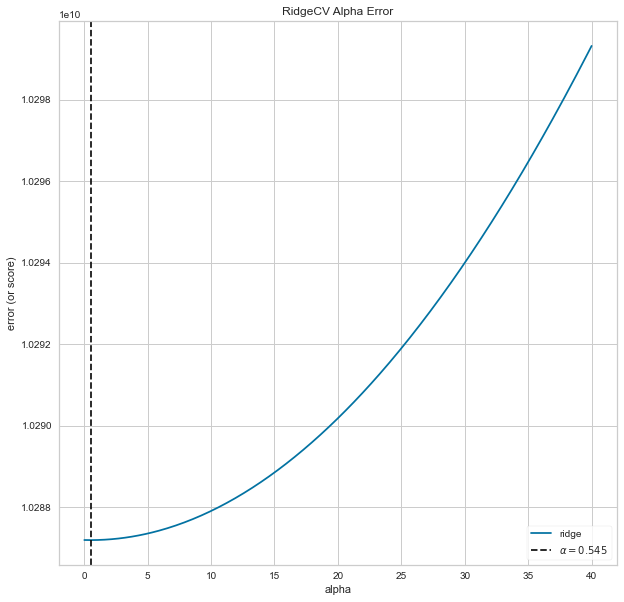

<AxesSubplot:title={'center':'RidgeCV Alpha Error'}, xlabel='alpha', ylabel='error (or score)'>

In [80]:
plt.figure(figsize=(10, 10))
visualizer = AlphaSelection(
    RidgeCV(alphas=alpha_space)
)
visualizer.fit(X_train, y_train)
visualizer.show()

In [81]:
rm = Ridge(alpha=0.545, random_state=42)

In [82]:
rm.fit(X_train, y_train)

Ridge(alpha=0.545, random_state=42)

In [83]:
rm.score(X_train, y_train)

0.9179787247746746

In [84]:
rm.score(X_test, y_test)

0.9179972136136312

In [85]:
rm_pred = rm.predict(X_test)

In [86]:
print_evaluate(y_test, rm_pred)

MAE: 80878.37005132734
MSE: 10089004019.086395
RMSE: 100444.03426329707
R2 Square 0.9179972136136312
__________________________________


In [87]:
final_scores = final_scores.join(pd.Series([80878.37005132732, 10089004019.086391, 100444.03426329704, 0.9179972136136312], name='RidgeModel', index=['MAE', 'MSE', 'RMSE', 'R2_Score']))

In [88]:
final_scores

,LinearModel,RidgeModel
MAE,80879.0972348944,80878.3700513273
MSE,89009300.8939879984,10089004019.0863914490
RMSE,100444.0605555848,100444.0342632970
R2_Score,0.9179971707,0.9179972136


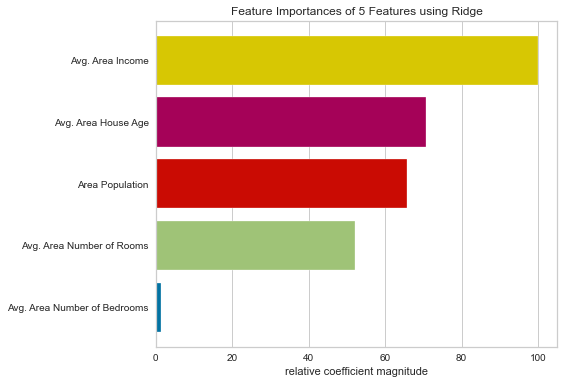

<AxesSubplot:title={'center':'Feature Importances of 5 Features using Ridge'}, xlabel='relative coefficient magnitude'>

In [89]:
viz = FeatureImportances(Ridge(alpha=0.545, random_state=42), labels=X.columns)
viz.fit(X_train, y_train)
viz.show()

In [90]:
rm.coef_

array([231709.34014602, 163557.6900214 , 120702.82458228,   3002.70817202,
       152214.15872138])

### Lasso Regression

In [91]:
lr = Lasso(random_state=42)

In [92]:
lr.alpha

1.0

In [93]:
lr.fit(X_train, y_train)

Lasso(random_state=42)

In [94]:
lr.score(X_train, y_train)

0.9179787435312492

In [95]:
lr.score(X_test, y_test)

0.9179972521079874

In [96]:
clf = GridSearchCV(Lasso(random_state=42), param_grid=alpha_dict, n_jobs=-1)

In [97]:
clf.fit(X_train, y_train)

GridSearchCV(estimator=Lasso(random_state=42), n_jobs=-1,
             param_grid={'alpha': array([ 0.01      ,  0.14374582,  0.27749164,  0.41123746,  0.54498328,
        0.6787291 ,  0.81247492,  0.94622074,  1.07996656,  1.21371237,
        1.34745819,  1.48120401,  1.61494983,  1.74869565,  1.88244147,
        2.01618729,  2.14993311,  2.28367893,  2.41742475,  2.55117057,
        2.68491639,  2.81866221,  2.95240803,  3.08615385,  3.21989967...
       36.12137124, 36.25511706, 36.38886288, 36.5226087 , 36.65635452,
       36.79010033, 36.92384615, 37.05759197, 37.19133779, 37.32508361,
       37.45882943, 37.59257525, 37.72632107, 37.86006689, 37.99381271,
       38.12755853, 38.26130435, 38.39505017, 38.52879599, 38.66254181,
       38.79628763, 38.93003344, 39.06377926, 39.19752508, 39.3312709 ,
       39.46501672, 39.59876254, 39.73250836, 39.86625418, 40.        ])})

In [98]:
clf.best_params_

{'alpha': 1.3474581939799333}

In [99]:
clf.best_score_

0.9174131973497808

In [100]:
lr = Lasso(alpha=1.3474581939799333, random_state=42)

In [101]:
lr.fit(X_train, y_train)

Lasso(alpha=1.3474581939799333, random_state=42)

In [102]:
lr_pred = lr.predict(X_test)

In [103]:
lr.score(X_train, y_train)

0.9179787434812468

In [104]:
lr.score(X_test, y_test)

0.9179974292157917

In [105]:
print_evaluate(y_test, lr_pred)

MAE: 80878.99115780405
MSE: 10088977493.023546
RMSE: 100443.9022192166
R2 Square 0.9179974292157917
__________________________________


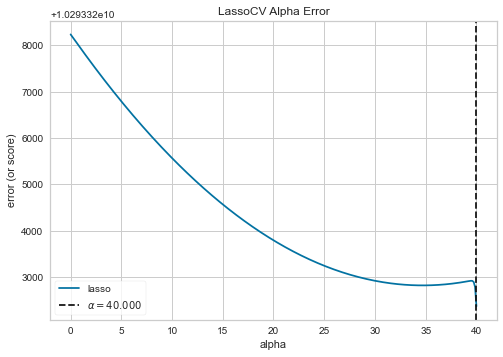

<AxesSubplot:title={'center':'LassoCV Alpha Error'}, xlabel='alpha', ylabel='error (or score)'>

In [106]:
visualizer = AlphaSelection(
    LassoCV(alphas=alpha_space, random_state=42)
)
visualizer.fit(X_train, y_train)
visualizer.show()

In [107]:
lr = Lasso(alpha=40, random_state=42)

In [108]:
lr.fit(X_train, y_train)

Lasso(alpha=40, random_state=42)

In [109]:
lr_pred = lr.predict(X_test)

In [110]:
print_evaluate(y_test, lr_pred)

MAE: 80877.71295992234
MSE: 10088815900.887579
RMSE: 100443.09782602078
R2 Square 0.9179987426264498
__________________________________


In [111]:
final_scores = final_scores.join(pd.Series([80877.71295992234, 10088815900.887579, 100443.09782602078, 0.9179987426264498], name='LassoModel', index=['MAE', 'MSE', 'RMSE', 'R2_Score']))

In [112]:
final_scores

,LinearModel,RidgeModel,LassoModel
MAE,80879.0972348944,80878.3700513273,80877.7129599223
MSE,89009300.8939879984,10089004019.0863914490,10088815900.8875789642
RMSE,100444.0605555848,100444.0342632970,100443.0978260208
R2_Score,0.9179971707,0.9179972136,0.9179987426


### Polynomial Regression

In [113]:
X_train_poly, X_test_poly, y_train_poly, y_test_poly = train_test_split(X, y, test_size=0.2, random_state=42)

In [114]:
poly_reg = PolynomialFeatures(degree=2, include_bias=False)

In [115]:
X_train_poly = poly_reg.fit_transform(X_train_poly)

In [116]:
X_test_poly = poly_reg.transform(X_test_poly)

In [117]:
X_train_poly.shape

(4000, 20)

In [118]:
scaler_2 = StandardScaler()

In [119]:
X_train_poly_scaled = scaler_2.fit_transform(X_train_poly)

In [120]:
X_test_poly_scaled = scaler_2.transform(X_test_poly)

In [121]:
lin_reg = LinearRegression()

In [122]:
lin_reg.fit(X_train_poly_scaled, y_train_poly)

LinearRegression()

In [123]:
lin_reg.score(X_train_poly_scaled, y_train_poly)

0.9181470377725716

In [124]:
lin_reg.score(X_test_poly_scaled, y_test_poly)

0.9179137874167399

In [125]:
ridge = Ridge(random_state=42)

In [126]:
ridge.fit(X_train_poly_scaled, y_train_poly)

Ridge(random_state=42)

In [127]:
ridge.score(X_train_poly_scaled, y_train_poly)

0.9181344339312335

In [128]:
ridge.score(X_test_poly_scaled, y_test_poly)

0.9178632978176942

In [129]:
clf = GridSearchCV(Ridge(random_state=42), param_grid=alpha_dict, n_jobs=-1)

In [130]:
clf.fit(X_train_poly_scaled, y_train_poly)

GridSearchCV(estimator=Ridge(random_state=42), n_jobs=-1,
             param_grid={'alpha': array([ 0.01      ,  0.14374582,  0.27749164,  0.41123746,  0.54498328,
        0.6787291 ,  0.81247492,  0.94622074,  1.07996656,  1.21371237,
        1.34745819,  1.48120401,  1.61494983,  1.74869565,  1.88244147,
        2.01618729,  2.14993311,  2.28367893,  2.41742475,  2.55117057,
        2.68491639,  2.81866221,  2.95240803,  3.08615385,  3.21989967...
       36.12137124, 36.25511706, 36.38886288, 36.5226087 , 36.65635452,
       36.79010033, 36.92384615, 37.05759197, 37.19133779, 37.32508361,
       37.45882943, 37.59257525, 37.72632107, 37.86006689, 37.99381271,
       38.12755853, 38.26130435, 38.39505017, 38.52879599, 38.66254181,
       38.79628763, 38.93003344, 39.06377926, 39.19752508, 39.3312709 ,
       39.46501672, 39.59876254, 39.73250836, 39.86625418, 40.        ])})

In [131]:
clf.best_params_

{'alpha': 1.0799665551839466}

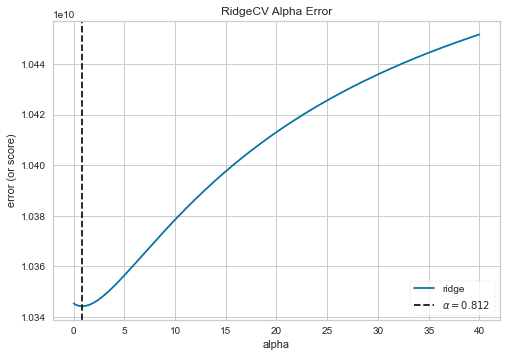

<AxesSubplot:title={'center':'RidgeCV Alpha Error'}, xlabel='alpha', ylabel='error (or score)'>

In [132]:
visualizer = AlphaSelection(
    RidgeCV(alphas=alpha_space)
)
visualizer.fit(X_train_poly_scaled, y_train_poly)
visualizer.show()

In [133]:
ridge = Ridge(alpha=0.812, random_state=42)

In [134]:
ridge.fit(X_train_poly_scaled, y_train_poly)

Ridge(alpha=0.812, random_state=42)

In [135]:
ridge.score(X_train_poly_scaled, y_train_poly)

0.9181384499900058

In [136]:
ridge.score(X_test_poly_scaled, y_test_poly)

0.9178741746855189

In [137]:
rm_poly_pred = ridge.predict(X_test_poly_scaled)

In [138]:
print_evaluate(y_test_poly, rm_poly_pred)

MAE: 80888.86316040858
MSE: 10104141800.312265
RMSE: 100519.36032582114
R2 Square 0.9178741746855189
__________________________________


In [139]:
final_scores = final_scores.join(pd.Series([80888.86316040847, 10104141800.312243, 100519.36032582104, 0.917874174685519], name='PolyRidgeModel', index=['MAE', 'MSE', 'RMSE', 'R2_Score']))

In [140]:
final_scores

,LinearModel,RidgeModel,LassoModel,PolyRidgeModel
MAE,80879.0972348944,80878.3700513273,80877.7129599223,80888.8631604085
MSE,89009300.8939879984,10089004019.0863914490,10088815900.8875789642,10104141800.3122425079
RMSE,100444.0605555848,100444.0342632970,100443.0978260208,100519.3603258210
R2_Score,0.9179971707,0.9179972136,0.9179987426,0.9178741747


### PolyLasso Model

In [141]:
lasso = Lasso(random_state=42, max_iter=1000000)

In [142]:
lasso.fit(X_train_poly_scaled, y_train_poly)

Lasso(max_iter=1000000, random_state=42)

In [143]:
lasso.score(X_train_poly_scaled, y_train_poly)

0.9181470164358504

In [144]:
lasso.score(X_test_poly_scaled, y_test_poly)

0.917913779793659

In [145]:
clf = GridSearchCV(Lasso(random_state=42), alpha_dict, n_jobs=-1, verbose=2)

In [146]:
clf.fit(X_train_poly_scaled, y_train_poly)

Fitting 5 folds for each of 300 candidates, totalling 1500 fits


GridSearchCV(estimator=Lasso(random_state=42), n_jobs=-1,
             param_grid={'alpha': array([ 0.01      ,  0.14374582,  0.27749164,  0.41123746,  0.54498328,
        0.6787291 ,  0.81247492,  0.94622074,  1.07996656,  1.21371237,
        1.34745819,  1.48120401,  1.61494983,  1.74869565,  1.88244147,
        2.01618729,  2.14993311,  2.28367893,  2.41742475,  2.55117057,
        2.68491639,  2.81866221,  2.95240803,  3.08615385,  3.21989967...
       36.12137124, 36.25511706, 36.38886288, 36.5226087 , 36.65635452,
       36.79010033, 36.92384615, 37.05759197, 37.19133779, 37.32508361,
       37.45882943, 37.59257525, 37.72632107, 37.86006689, 37.99381271,
       38.12755853, 38.26130435, 38.39505017, 38.52879599, 38.66254181,
       38.79628763, 38.93003344, 39.06377926, 39.19752508, 39.3312709 ,
       39.46501672, 39.59876254, 39.73250836, 39.86625418, 40.        ])},
             verbose=2)

In [147]:
clf.best_params_

{'alpha': 40.0}

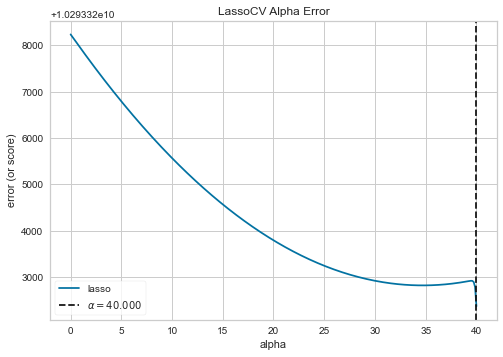

<AxesSubplot:title={'center':'LassoCV Alpha Error'}, xlabel='alpha', ylabel='error (or score)'>

In [148]:
visualizer = AlphaSelection(
    LassoCV(alphas=alpha_space, random_state=42)
)
visualizer.fit(X_train, y_train)
visualizer.show()

In [149]:
lasso = Lasso(max_iter=10000000, alpha=40, random_state=42)

In [150]:
lasso.fit(X_train_poly_scaled, y_train_poly)

Lasso(alpha=40, max_iter=10000000, random_state=42)

In [151]:
lasso.score(X_train_poly_scaled, y_train_poly)

0.9181205435334685

In [152]:
lasso.score(X_test_poly_scaled, y_test_poly)

0.9178212263017468

In [153]:
lasso.coef_

array([195163.8158515 , 152314.92513397, 106128.57658922,   1215.87408762,
       156347.88747909,  23866.03797143,   9946.77407861,     -0.        ,
         8454.7174535 ,   4666.66145211,   9652.36835239,    107.05650534,
        -5821.1976573 ,  -5715.89997923,  14642.80773143,   -174.51139463,
           -0.        ,     -0.        ,   -606.19360298,  -3091.4711256 ])

In [154]:
lasso_pred = lasso.predict(X_test_poly_scaled)

In [155]:
print_evaluate(y_test_poly, lasso_pred)

MAE: 80913.26671704587
MSE: 10110656169.887028
RMSE: 100551.75866133336
R2 Square 0.9178212263017468
__________________________________


In [156]:
final_scores = final_scores.join(pd.Series([80886.63136926523, 10099269086.678867, 100495.11971572982, 0.917913779793659], name='PolyLassoModel', index=['MAE', 'MSE', 'RMSE', 'R2_Score']))

In [157]:
final_scores

,LinearModel,RidgeModel,LassoModel,PolyRidgeModel,PolyLassoModel
MAE,80879.0972348944,80878.3700513273,80877.7129599223,80888.8631604085,80886.6313692652
MSE,89009300.8939879984,10089004019.0863914490,10088815900.8875789642,10104141800.3122425079,10099269086.6788673401
RMSE,100444.0605555848,100444.0342632970,100443.0978260208,100519.3603258210,100495.1197157298
R2_Score,0.9179971707,0.9179972136,0.9179987426,0.9178741747,0.9179137798


In [158]:
final_scores.loc['R2_Score', :].max()

0.9179987426264498